In [ ]:
!pip install pyyaml==5.1
!pip3 install torch==1.10 torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu113

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 8.1 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=4bf538417438740552d3bd4312a2ecaef5839f478726ecef1398bcf19e91b80f
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu113
     |██████████████▋                 | 834.1 MB 11.3 MB/s eta 0:01:28tcmalloc: large alloc 1147494400 bytes == 0x3a854000 @  0x7f904589f615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |█

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
!curl -L "https://public.roboflow.com/ds/Nh6gZiWKmi?key=MsPAd8qdjC" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1366      0 --:--:-- --:--:-- --:--:--  1364
100 9041k  100 9041k    0     0  8627k      0  0:00:01  0:00:01 --:--:-- 8627k
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/BloodImage_00038_jpg.rf.63d04b5c9db95f32fa7669f72e4903ca.jpg  
 extracting: test/BloodImage_00044_jpg.rf.589ee3d351cb6d9a3f7b7a942da5370a.jpg  
 extracting: test/BloodImage_00062_jpg.rf.1cecc20a21ac39cb54cf532081a1e893.jpg  
 extracting: test/BloodImage_00090_jpg.rf.5267690cb6a13608d39b0424bef3c9b4.jpg  
 extracting: test/BloodImage_00099_jpg.rf.744666666386a07e242e214e041945ba.jpg  
 extracting: test/BloodImage_00112_jpg.rf.e4b507506c4a70882bb23cb743061a66.jpg  
 extracting: test/BloodImage_00113_jpg.rf.250f3f0288ad89f4f961529434d99713.jpg  

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")

WARNING [05/12 17:35:43 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/12 17:35:43 d2.data.datasets.coco]: Loaded 255 images in COCO format from /content/train/_annotations.coco.json


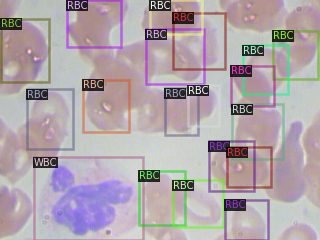

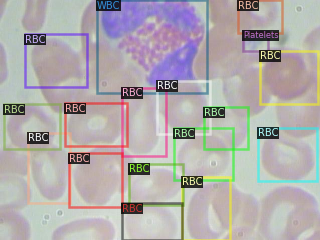

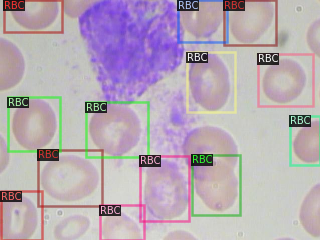

In [ ]:
#visualize training data
#stores metadata
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
#stores data
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"]) #loads image from file
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5 )
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000 #1000
cfg.SOLVER.MAX_ITER = 1501 #1501 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

cfg.TEST.EVAL_PERIOD = 500



In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
os.makedirs(cfg.OUTPUT_DIR,exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/12 17:35:51 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:06, 63.1MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_p

[05/12 17:36:05 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/12 17:36:57 d2.utils.events]:  eta: 1:04:41  iter: 19  total_loss: 3.569  loss_cls: 1.692  loss_box_reg: 0.8301  loss_rpn_cls: 0.9746  loss_rpn_loc: 0.09636  time: 2.5930  data_time: 0.0255  lr: 1.931e-06  max_mem: 9384M
[05/12 17:37:52 d2.utils.events]:  eta: 1:05:34  iter: 39  total_loss: 3.16  loss_cls: 1.628  loss_box_reg: 0.8731  loss_rpn_cls: 0.6132  loss_rpn_loc: 0.08987  time: 2.6678  data_time: 0.0107  lr: 2.911e-06  max_mem: 9384M
[05/12 17:38:51 d2.utils.events]:  eta: 1:06:23  iter: 59  total_loss: 2.738  loss_cls: 1.538  loss_box_reg: 0.9038  loss_rpn_cls: 0.2755  loss_rpn_loc: 0.08186  time: 2.7546  data_time: 0.0089  lr: 3.891e-06  max_mem: 9384M
[05/12 17:39:48 d2.utils.events]:  eta: 1:05:36  iter: 79  total_loss: 2.584  loss_cls: 1.456  loss_box_reg: 0.8557  loss_rpn_cls: 0.2031  loss_rpn_loc: 0.08002  time: 2.7814  data_time: 0.0110  lr: 4.871e-06  max_mem: 9384M
[05/12 17:40:44 d2.utils.events]:  eta: 1:04:30  iter: 99  total_loss: 2.523  loss_cls: 1.377  loss_b

In [ ]:
from detectron2.checkpoint import DetectionCheckpointer
checkpointer = DetectionCheckpointer(trainer.model, save_dir=cfg.OUTPUT_DIR)

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [05/12 18:49:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/12 18:49:26 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/12 18:49:26 d2.data.datasets.coco]: Loaded 36 images in COCO format from /content/test/_annotations.coco.json
[05/12 18:49:26 d2.data.build]: Distribution of instances among all 4 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|   cells    | 0            | Platelets  | 36           |    RBC     | 398          |
|    WBC     | 37           |            |              |            |              |
|   total    | 471          |            |              |            |              |
[05/12 18:49:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentat

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[05/12 18:49:30 d2.evaluation.evaluator]: Inference done 11/36. Dataloading: 0.0011 s/iter. Inference: 0.2645 s/iter. Eval: 0.0003 s/iter. Total: 0.2658 s/iter. ETA=0:00:06
[05/12 18:49:35 d2.evaluation.evaluator]: Inference done 30/36. Dataloading: 0.0013 s/iter. Inference: 0.2641 s/iter. Eval: 0.0002 s/iter. Total: 0.2658 s/iter. ETA=0:00:01
[05/12 18:49:36 d2.evaluation.evaluator]: Total inference time: 0:00:08.340028 (0.269033 s / iter per device, on 1 devices)
[05/12 18:49:36 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.263793 s / iter per device, on 1 devices)
[05/12 18:49:36 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/12 18:49:37 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[05/12 18:49:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[05/12 18:49:37 d2.evaluation.f

OrderedDict([('bbox',
              {'AP': 55.35691162670206,
               'AP-Platelets': 34.81793702478558,
               'AP-RBC': 58.342878474303376,
               'AP-WBC': 72.90991938101723,
               'AP-cells': nan,
               'AP50': 83.72521494964114,
               'AP75': 60.5093928480521,
               'APl': 46.20589631072033,
               'APm': 43.660254094025326,
               'APs': 14.65382056462598})])

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


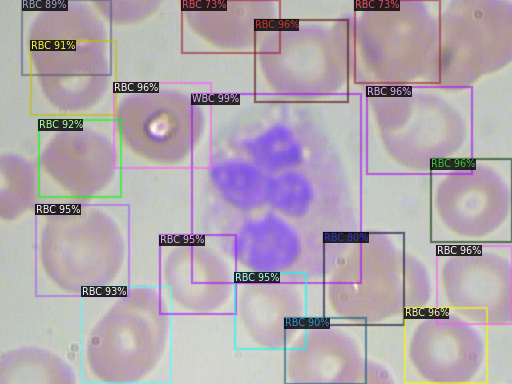

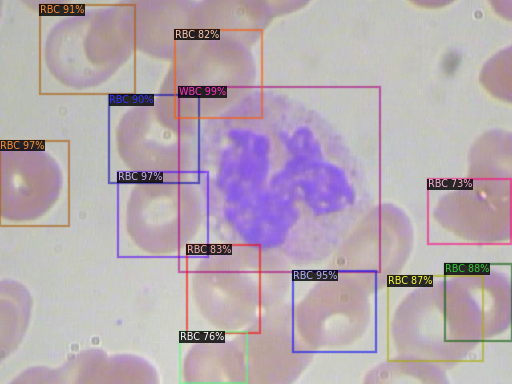

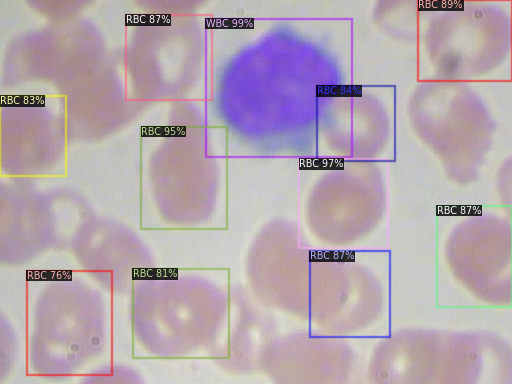

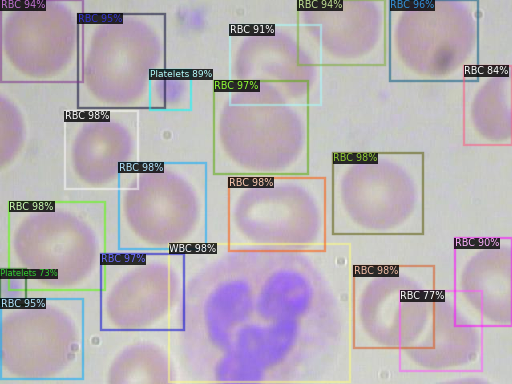

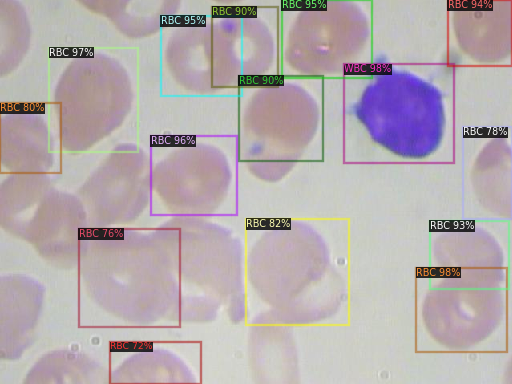

...

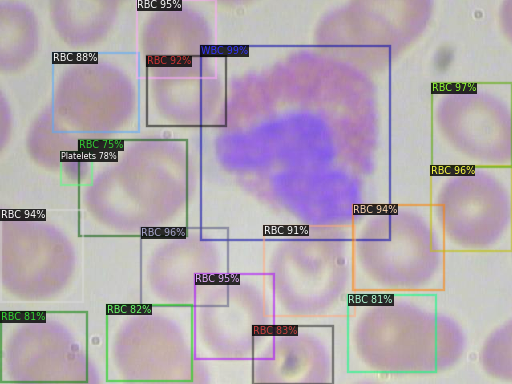

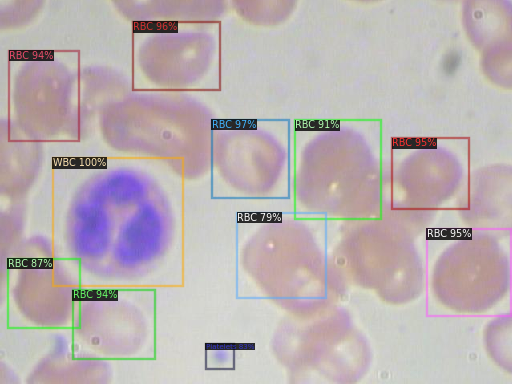

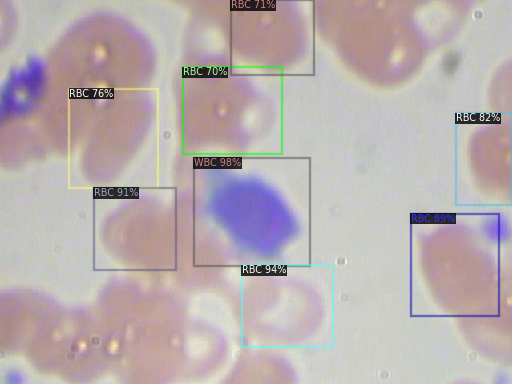

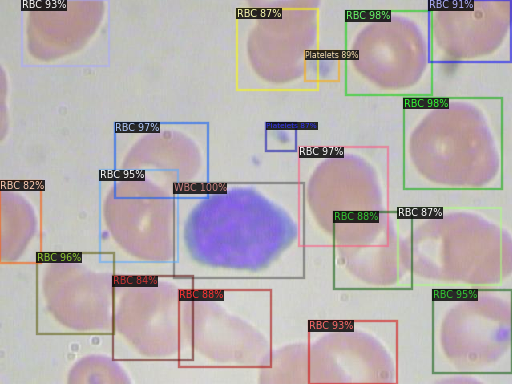

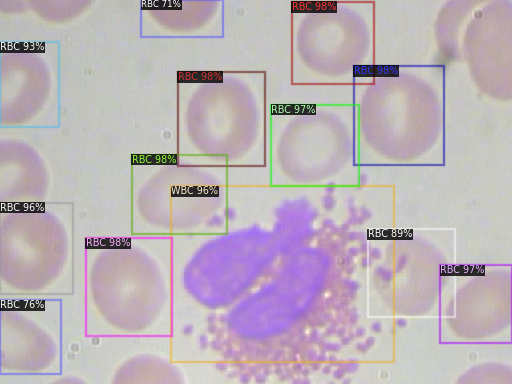

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
import cv2
from detectron2.utils.video_visualizer import VideoVisualizer

video = cv2.VideoCapture('/content/bloodflow_video/50x50 micrometer channel D 0.06ul per min 40x without dextran 01.mp4')
if (video.isOpened()==False):
  print("Error")
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
video_writer = cv2.VideoWriter('out.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)
v = VideoVisualizer(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), ColorMode.IMAGE)

Error


In [ ]:
from detectron2.utils.visualizer import ColorMode
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.001   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
for imageName in glob.glob('/content/t2*.jpg'):
  im = cv2.imread(imageName)
 # cropped_im=im[50:2500,650:1000]
 # cv2_imshow(cropped_im)
  outputs = predictor(im)
  v = Visualizer(im[50:100,750:800, ::-1],
                metadata=test_metadata, 
                scale=5
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.utils.visualizer import ColorMode
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.001   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
for imageName in glob.glob('/content/t3*.jpg'):
  im = cv2.imread(imageName)
 # cropped_im=im[50:2500,650:1000]
 # cv2_imshow(cropped_im)
  outputs = predictor(im)
  v = Visualizer(im[:,:, ::-1],
                metadata=test_metadata, 
                scale=1
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
import cv2
from detectron2.utils.visualizer import ColorMode
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.01   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)

cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = cap.get(cv2.CAP_PROP_FPS)
num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
#out = cv2.VideoWriter('200x200withoutDEXTRAN_.01_scale_1.2.mp4',cv2.VideoWriter_fourcc(*'XMP4'), 60,(height,width))




i_array = []

width = int(cap.get(3))
height = int(cap.get(4))
#outt = cv2.VideoWriter('1tester', cv2.VideoWriter_fourcc(*'DIVX'), 60, (width, height))
i=0
while cap.isOpened():
  if(i>int(cap.get(cv2.CAP_PROP_FRAME_COUNT)-1)):
    ret, image = cap.read()
    #outt.write(v.get_image()[:, :, ::-1])
    i_array.append(v.get_image()[:, :, ::-1])
    cap.release()
    #outt.release()
    #out.write(image)
    break   
  ret, image = cap.read()
  height,width,layers=image.shape
  size=(width,height)  
  i+=1
  outputs = predictor(image)
  #outt = cv2.VideoWriter('/content/1tester', cv2.VideoWriter_fourcc(*'DIVX'), 60, (width, height))
  v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  i_array.append(v.get_image()[:, :, ::-1])
  #outt.write(v.get_image()[:, :, ::-1])
  #cv2.imwrite('/content/results/'+chr(i)+'.jpg',v.get_image()[:, :, ::-1])
  #cv2_imshow(v.get_image()[:, :, ::-1])
  #if cv2.waitKey(25) & 0xFF == ord('q'):
    #break




out = cv2.VideoWriter('/content/project10.avi',cv2.VideoWriter_fourcc(*'DIVX'), 60, size,isColor=False)

for i in range(len(i_array)):
    out.write(i_array[i])
    #cv2_imshow(i_array[i])
out.release()
  #out.write(image)
cap.release()
#outt.release()
cv2.destroyAllWindows()


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


In [ ]:
i_array[i].shape

(864, 429, 3)

In [ ]:
import cv2
import numpy as np
import glob
i=0
img_array = []
for filename in glob.glob('results/*.jpg'):

    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width,height)
    img_array.append(img)
    
    if i==0:
      out = cv2.VideoWriter('/content/project4.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
    #print(img_array[0].shape)
    out.write(img_array[i])
    i+=1

out.release()
 



In [ ]:
import cv2
from detectron2.utils.visualizer import ColorMode
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.01   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)

cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = cap.get(cv2.CAP_PROP_FPS)
num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
out = cv2.VideoWriter('200x200withoutDEXTRAN_.01_scale_1.2.mp4',cv2.VideoWriter_fourcc(*'XMP4'), 60,(height,width))




i_array = []

width = int(cap.get(3))
height = int(cap.get(4))
#outt = cv2.VideoWriter('1tester', cv2.VideoWriter_fourcc(*'DIVX'), 60, (width, height))
i=0
while cap.isOpened():
  if(i>int(cap.get(cv2.CAP_PROP_FRAME_COUNT)-1)):
    ret, image = cap.read()
    #outt.write(v.get_image()[:, :, ::-1])
    i_array.append(v.get_image()[:, :, ::-1])
    out.write(v.get_image()[:, :, ::-1])
    cap.release()
    out.release()
    #outt.release()
    #out.write(image)
    break   
  ret, image = cap.read()
  height,width,layers=image.shape
  size=(width,height)  
  if i==0:
      out = cv2.VideoWriter('/content/project7.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
  i+=1
  outputs = predictor(image)
  v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  i_array.append(v.get_image()[:, :, ::-1])
  out.write(v.get_image()[:, :, ::-1])





out.release()
  #out.write(image)
cap.release()
#outt.release()
cv2.destroyAllWindows()


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


In [ ]:
#from torch._C import uint8

i=0
img_array = []
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.01   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)

cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')


while cap.isOpened():  
    if(i>60): #int(cap.get(cv2.CAP_PROP_FRAME_COUNT)-1)):
      break
    ret, image = cap.read()
    height,width,layers=image.shape
    size = (width,height)

    if i==0:
        out = cv2.VideoWriter('/content/aproject1.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 15, size)
    

    outputs = predictor(image)
    v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    img_array.append(v.get_image()[:, :, ::-1]) 
    #im_array.append(img_array[i])
    #print(type(img_array))
    arr = np.array(img_array, dtype='uint8')
    #print(type(arr))
    #print(img_array[i])
    out.write(arr[i])
    #print(type(image[:, :, ::-1]))
    print(type(v.get_image()[:, :, ::-1]))
    i+=1

out.release()
 



/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


KeyboardInterrupt: ignored

In [ ]:
ffmpeg -i before.mp4 -vf "crop=358:720:480:0" after.mp4

SyntaxError: ignored

In [ ]:
import cv2
import numpy as np
import glob
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.05   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
i=0
img_array = []
cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')


while cap.isOpened():  
    if(i>int(cap.get(cv2.CAP_PROP_FRAME_COUNT)-1)):
      break

    ret, g = cap.read()
    height,width,layers=g.shape
    size = (width,height)

    outputs = predictor(g)
    v = Visualizer(g[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.25)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    #img_array.append(v.get_image()[:, :, ::-1]) 
    cv2.imwrite('/content/results2/'+ str(i) +'.jpg',v.get_image()[:, :, ::-1])
    i+=1


for i in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT)-1)):

    img = cv2.imread('/content/results2/'+str(i)+'.jpg')
    height, width, layers = img.shape
    size = (width,height)
    img_array.append(img)
    
    #if i==0:
      #out = cv2.VideoWriter('/content/aproject4.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 15, size)
    #print(img_array[0].shape)
    #out.write(img_array[i])
    i+=1

#out.release()
 
out = cv2.VideoWriter('200x200_Threshold.05_Scale1.25.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 60, size)
 
for i in range(len(img_array)):
    out.write(img_array[i])
    print(type(img_array[i]))
out.release()

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.nd

In [ ]:
import numpy as np
import cv2
size = 720*16//9, 720
duration = 2
fps = 25
out = cv2.VideoWriter('output6.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (size[1], size[0]), False)
for _ in range(fps * duration):
    data = np.array(img_array, dtype='uint8')
    out.write(data)
out.release()

In [ ]:
!pip install scikit-video

     |████████████████████████████████| 2.3 MB 10.3 MB/s 


In [ ]:
import cv2
import numpy as np
import glob
from skvideo.io import VideoWriter
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.01   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
i=0
g_array = []
cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')


while cap.isOpened():  
    if i==60:
      break

    ret, g = cap.read()
    height,width,layers=g.shape
    size = (width,height)

    outputs = predictor(g)
    v = Visualizer(g[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    #img_array.append(v.get_image()[:, :, ::-1]) 
    cv2.imwrite('/content/results/'+'temp.jpg',v.get_image()[:, :, ::-1])
    #img_array.append('/content/results/'+'temp.jpg')
    img = cv2.imread('/content/results/'+'temp.jpg')

    g_array.append(img)
    !rm -rf <'/content/results/'+'temp.jpg'>
    
    if i==0:
      writer = VideoWriter('/content/lproject18.avi', size)
      writer.open()
      ot = VideoWriter('/content/lproject18.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
    #print(img_array[0].shape)
    #out.write(img_array[i])
    #cv2_imshow(img_array[i])
    writer.write(g_array[i])
    i+=1
for i in range(len(g_array)):
    ot.write(g_array[i])
    cv2_imshow(g_array[i])
ot.release()
  #out.write(image)
cap.release()

ImportError: ignored

In [ ]:
import cv2
import numpy as np
import glob
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.01   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
i=0
img_array = []
cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')


while cap.isOpened():  
    if i==60:
      break

    ret, img = cap.read()
    height,width,layers=img.shape
    size = (width,height)
    img_array.append(img)
    
    if i==0:
      out = cv2.VideoWriter('/content/lproject11.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
    #print(img_array[0].shape)
    out.write(img_array[i])
    i+=1

out.release()
 



In [ ]:
import skvideo.io
import numpy as np

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.01   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
i=0
img_array = []
cap = cv2.VideoCapture('/content/200x200withoutDEXTRAN.mp4')


while cap.isOpened():  
    if i==60:
      break

    ret, g = cap.read()
    height,width,layers=g.shape
    size = (width,height)

    outputs = predictor(g)
    v = Visualizer(g[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    skvideo.io.vwrite("outputvideo.mp4", outputdata)
    
    if i==0:
      out = cv2.VideoWriter('/content/lproject21.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
    #print(img_array[0].shape)
    out.write(g[:, :, ::-1])
    i+=1

out.release()
 



/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


NameError: ignored

<class 'list'>
<class 'numpy.ndarray'>


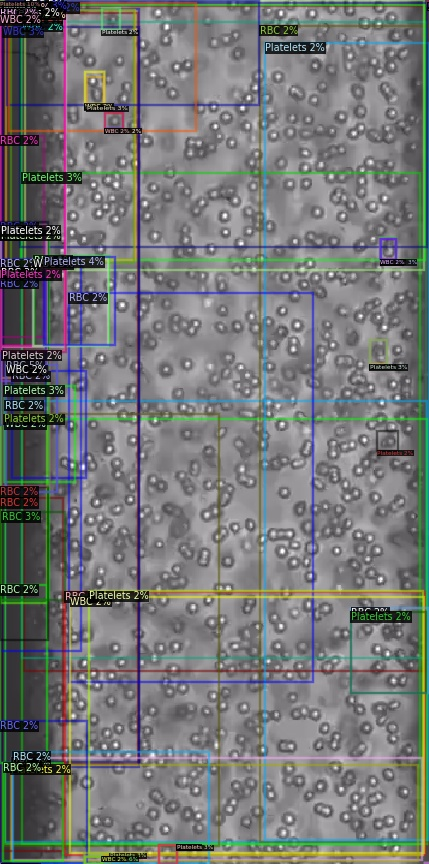

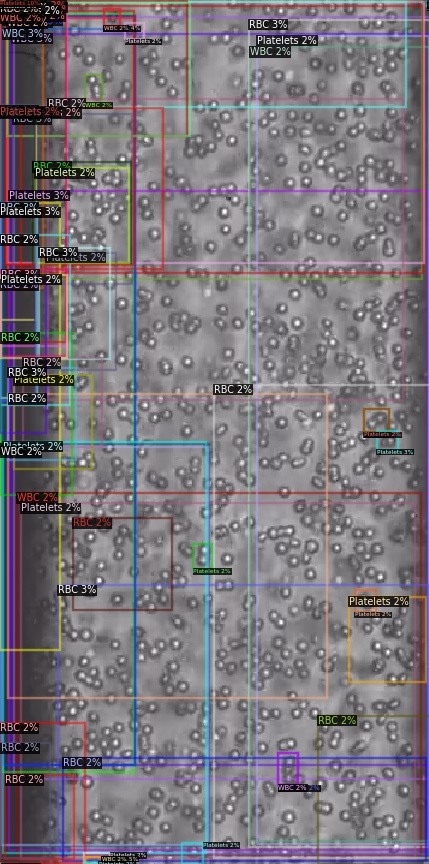

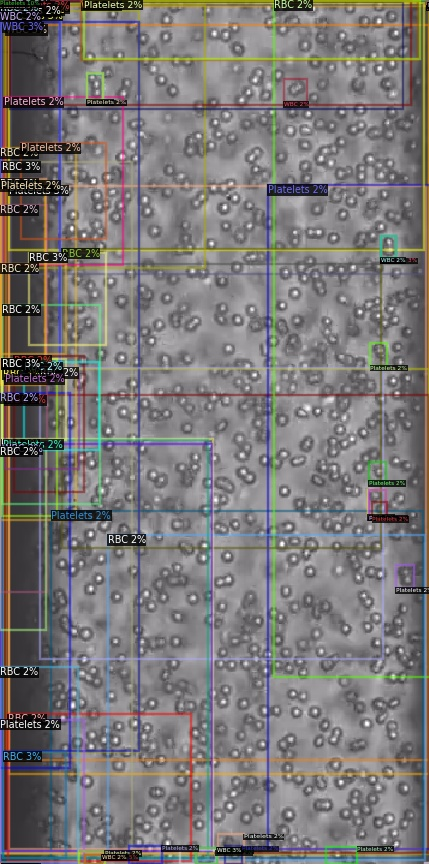

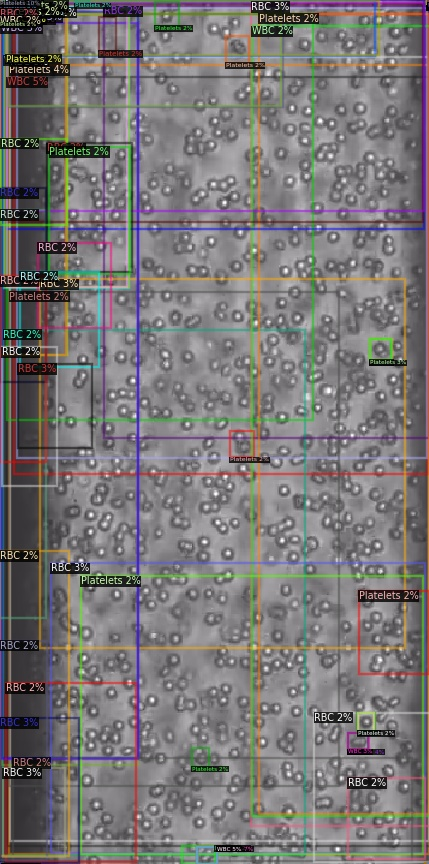

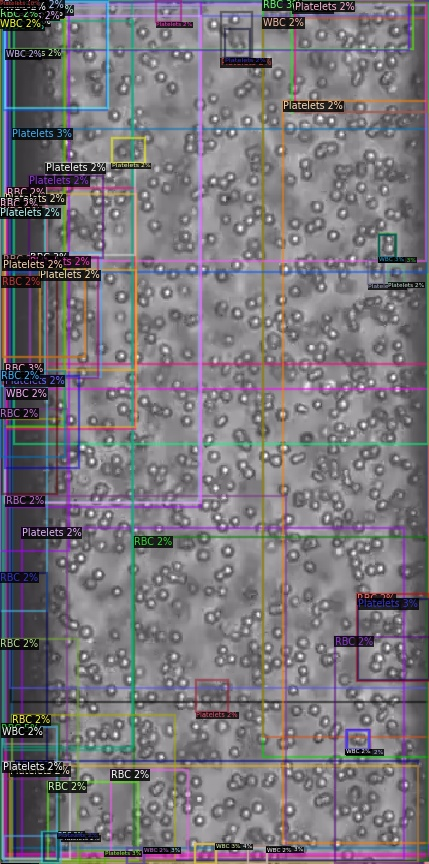

...

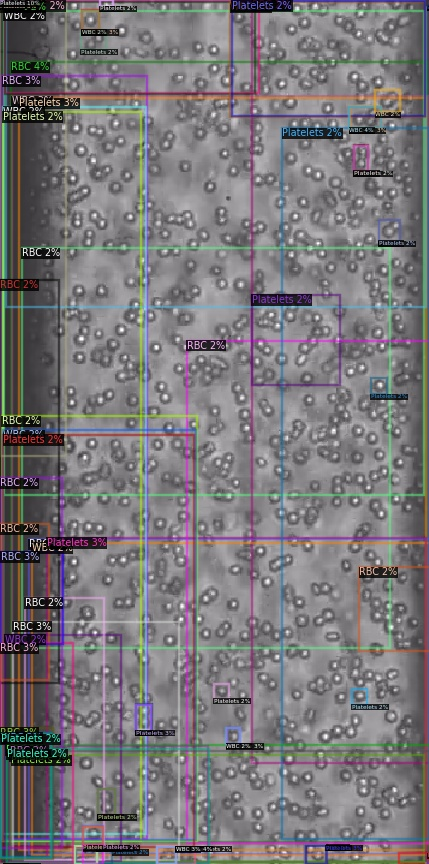

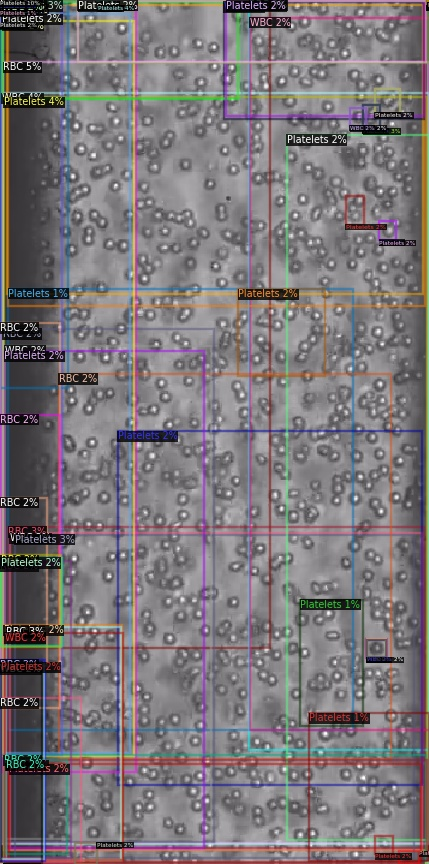

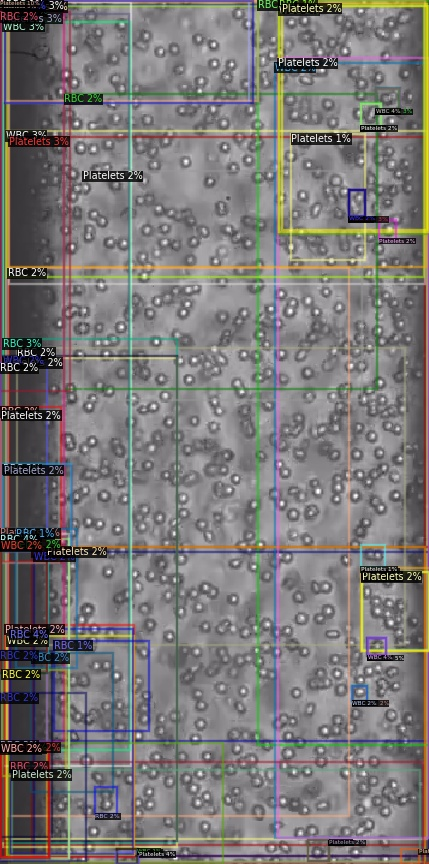

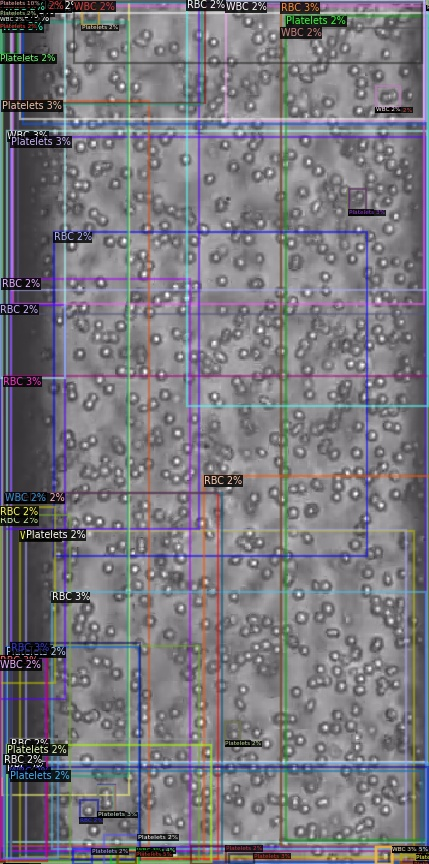

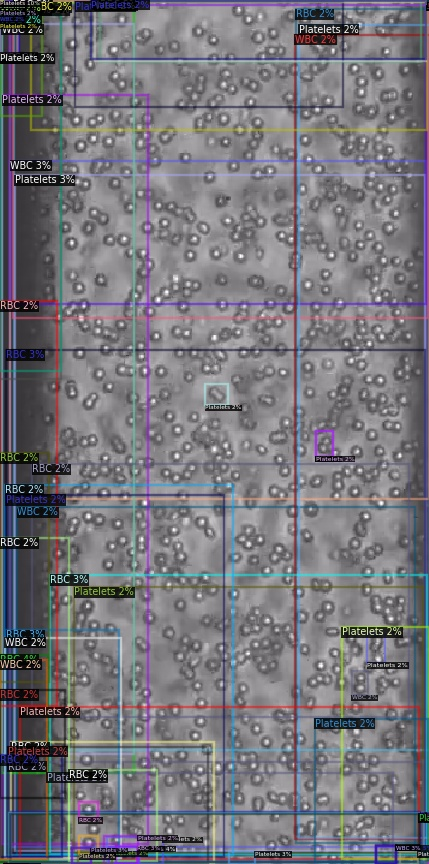

KeyboardInterrupt: ignored

In [ ]:
out = cv2.VideoWriter('/content/lproject20.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
print(type(img_array))
my_array=np.array(img_array,dtype='uint8')
print(type(my_array))
for i in range(len(img_array)):
  out.write(my_array[i])
  cv2_imshow(my_array[i])
  

In [ ]:
import numpy as np
import cv2
size = 720*16//9, 720
duration = 2
fps = 25
out = cv2.VideoWriter('output.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (size[1], size[0]), False)
out5 = cv2.VideoWriter('output5.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (size[1], size[0]), False)
m_array=np.array(img_array,dtype='uint8')
for _ in range(fps * duration):
    data = np.random.randint(0, 256, size, dtype='uint8')
    out.write(data)
    out5.write(m_array)
print(type(data))
print(type(m_array))
out.release()

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


   pred=predictor(frame)
      v = Visualizer(im[:, :, ::-1],
                    metadata=test_metadata, 
                    scale=0.8
                    )
      out = v.draw_panoptic_seg_predictions(predictions.to("cpu"))